In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [2]:
#drive'ı projeye ekleme
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!unzip cow.zip > /dev/null

In [4]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("cow_train", {}, "./cow/train/train_coco.json", "./cow/train")
register_coco_instances("cow_test", {}, "./cow/test/test_coco.json", "./cow/test")

In [5]:
cow_metadata = MetadataCatalog.get("cow_train")
print(cow_metadata)
dataset_dicts = DatasetCatalog.get("cow_train")
print(dataset_dicts)

Metadata(evaluator_type='coco', image_root='./cow/train', json_file='./cow/train/train_coco.json', name='cow_train')
[06/03 17:44:16 d2.data.datasets.coco]: Loaded 57 images in COCO format from ./cow/train/train_coco.json
[{'file_name': './cow/train/1_HolsteinAngusMelez_Back_LiveWeight_419_CarcassWeight_235_01.jpg', 'height': 1280, 'width': 961, 'image_id': 1, 'annotations': [{'iscrowd': 0, 'bbox': [489.0, 3.0, 319.0, 231.0], 'category_id': 0, 'segmentation': [[504.3684210526317, 65.78947368421052, 539.8947368421052, 82.89473684210526, 585.9473684210527, 101.3157894736842, 609.6315789473683, 114.47368421052632, 635.9473684210527, 138.1578947368421, 655.6842105263158, 164.4736842105263, 675.421052631579, 200.0, 700.421052631579, 234.21052631578948, 732.0, 222.3684210526316, 754.3684210526317, 209.21052631578948, 775.421052631579, 202.6315789473684, 795.1578947368421, 196.05263157894737, 793.8421052631579, 161.8421052631579, 783.3157894736842, 136.8421052631579, 766.2105263157894, 121.05

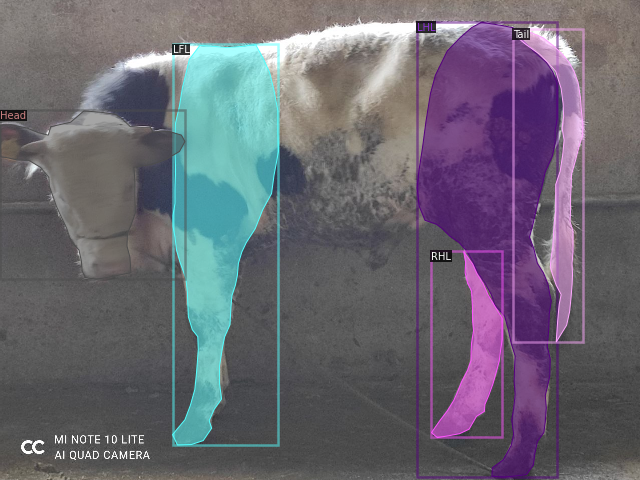

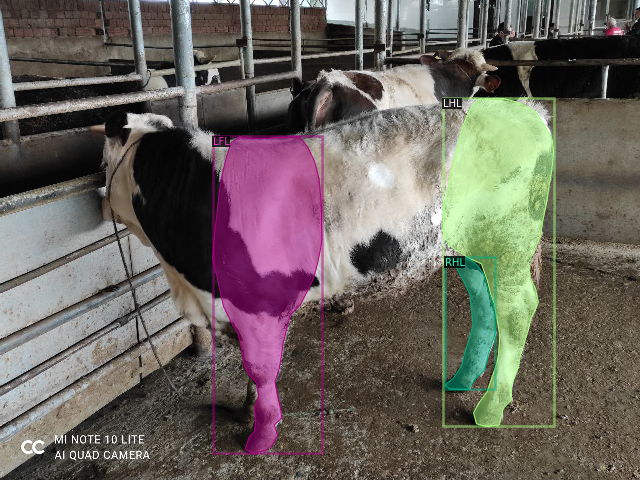

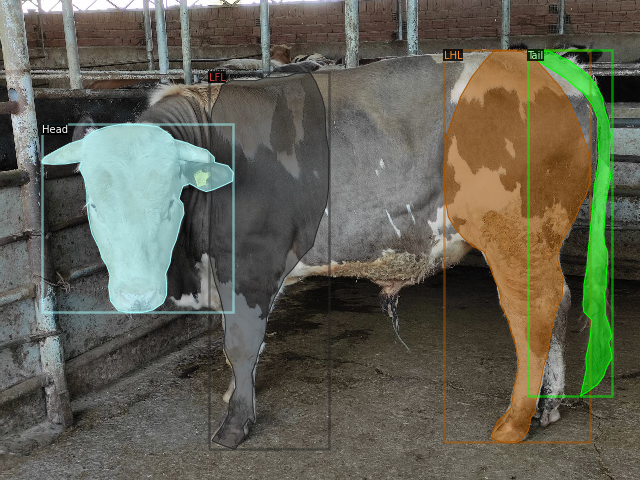

In [6]:
#training setinden örnekler
import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=cow_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [7]:
#model dosyası alınması
!wget https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl -q -O model_final_f10217.pkl

In [8]:
#modelin eğitimi
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("cow_train",)
cfg.DATASETS.TEST = ()  # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "./model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = (300)  # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = (128)  # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6  # 6 classes 

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/03 17:45:41 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (7, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (7,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (24, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (24,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (6, 256, 1, 1) 

[06/03 17:45:43 d2.engine.train_loop]: Starting training from iteration 0
[06/03 17:45:51 d2.utils.events]:  eta: 0:01:57  iter: 19  total_loss: 2.931  loss_cls: 1.372  loss_box_reg: 0.8992  loss_mask: 0.6891  loss_rpn_cls: 0.08765  loss_rpn_loc: 0.05811  time: 0.4140  data_time: 0.0220  lr: 0.00039962  max_mem: 2334M
[06/03 17:46:00 d2.utils.events]:  eta: 0:01:50  iter: 39  total_loss: 2.49  loss_cls: 0.7947  loss_box_reg: 0.9679  loss_mask: 0.6319  loss_rpn_cls: 0.03286  loss_rpn_loc: 0.04788  time: 0.4220  data_time: 0.0081  lr: 0.00079922  max_mem: 2334M
[06/03 17:46:09 d2.utils.events]:  eta: 0:01:41  iter: 59  total_loss: 2.192  loss_cls: 0.7194  loss_box_reg: 0.91  loss_mask: 0.4672  loss_rpn_cls: 0.01493  loss_rpn_loc: 0.0703  time: 0.4256  data_time: 0.0092  lr: 0.0011988  max_mem: 2334M
[06/03 17:46:17 d2.utils.events]:  eta: 0:01:33  iter: 79  total_loss: 1.675  loss_cls: 0.5154  loss_box_reg: 0.776  loss_mask: 0.2989  loss_rpn_cls: 0.009214  loss_rpn_loc: 0.05427  time: 0.

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [14]:
register_coco_instances("cow_test1", {}, "./cow/test/test_coco.json", "./cow/test")

In [15]:
#tahmin nesnesi
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("cow_test1", )
predictor = DefaultPredictor(cfg)

[06/03 17:56:12 d2.data.datasets.coco]: Loaded 15 images in COCO format from ./cow/test/test_coco.json
./cow/test/1_Holstein_Back_LiveWeight_490_CarcassWeight_254_09.jpg
tensor([1, 2, 1], device='cuda:0')
Boxes(tensor([[ 377.4391,   34.0847,  489.2235,  924.9618],
        [ 176.8002,   19.5003,  447.3386, 1198.9249],
        [ 408.9292,   48.4245,  598.3195,  904.7460]], device='cuda:0'))


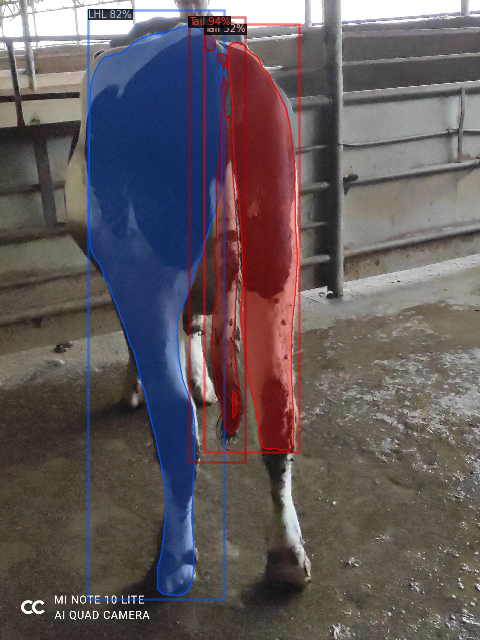

./cow/test/1_Holstein_Back_LiveWeight_490_CarcassWeight_254_08.jpg
tensor([1, 2, 1, 4], device='cuda:0')
Boxes(tensor([[ 348.7222,   16.9180,  476.0132,  844.9572],
        [ 168.0165,    5.4549,  410.7097, 1196.1982],
        [ 397.4573,    6.8479,  472.9919,  698.7435],
        [ 342.4201,  612.0763,  421.1497,  784.6281]], device='cuda:0'))


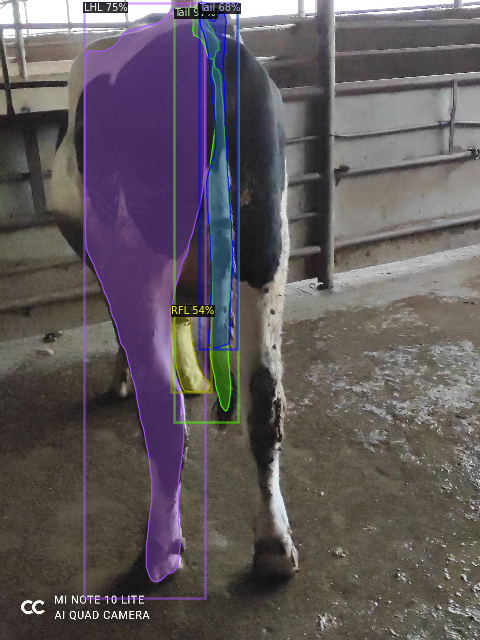

./cow/test/1_Holstein_Side_LiveWeight_490_CarcassWeight_254_02.jpg
tensor([0, 1, 5, 2, 5], device='cuda:0')
Boxes(tensor([[   0.0000,   83.2580,  481.0121,  416.8230],
        [1101.0361,  155.9645, 1253.5492,  678.9574],
        [ 348.2318,  130.0775,  554.9894,  931.8607],
        [ 895.7490,  128.3750, 1228.5597,  934.0289],
        [ 912.4559,  136.9139, 1183.1127,  954.7547]], device='cuda:0'))


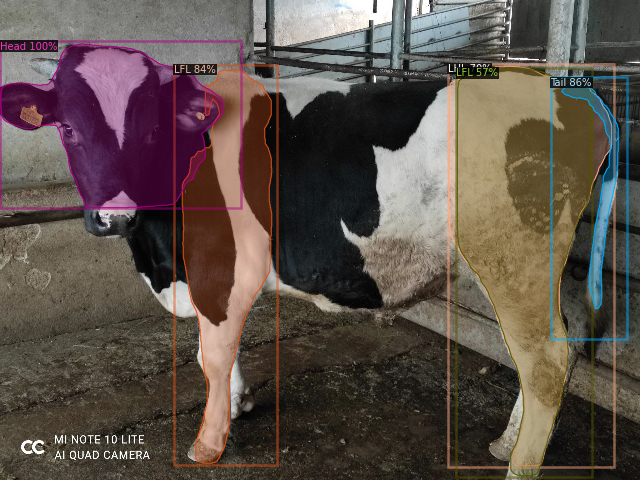

./cow/test/1_Holstein_Side_LiveWeight_490_CarcassWeight_254_05.jpg
tensor([0, 5, 2, 0, 4], device='cuda:0')
Boxes(tensor([[  65.1474,  145.5964,  314.7439,  378.5753],
        [ 428.1274,  200.5459,  613.4940,  811.5675],
        [ 839.0705,  192.0639, 1107.9609,  827.5683],
        [ 569.3611,  197.6526,  757.6993,  533.8644],
        [ 440.5119,  574.3821,  501.6914,  763.9881]], device='cuda:0'))


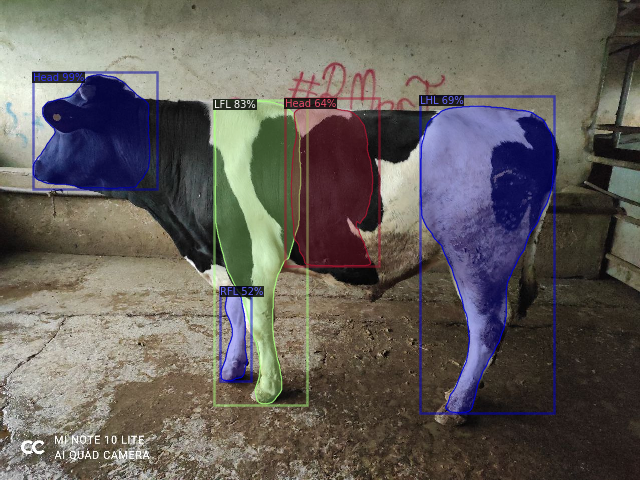

./cow/test/1_Holstein_Back_LiveWeight_490_CarcassWeight_254_07.jpg
tensor([2, 4, 1, 2, 1, 1], device='cuda:0')
Boxes(tensor([[ 184.2323,   97.4433,  433.7644, 1020.8510],
        [ 216.6841,  563.4973,  296.3153,  759.2535],
        [ 383.4435,  115.7019,  485.5420,  865.8013],
        [  21.2765,  116.7458,  233.3636,  818.4523],
        [ 138.4923,   96.8908,  241.1497,  584.8386],
        [ 118.7343,  125.6165,  288.8202,  704.7186]], device='cuda:0'))


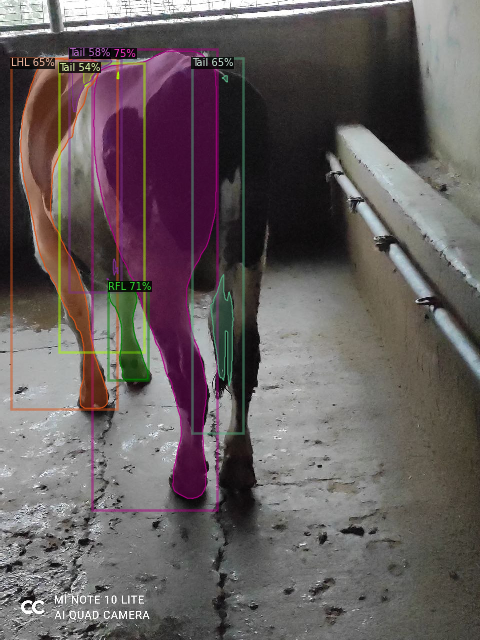

./cow/test/1_Holstein_Back_LiveWeight_490_CarcassWeight_254_03.jpg
tensor([1, 2, 1, 1], device='cuda:0')
Boxes(tensor([[ 434.1559,   13.8844,  554.6602,  904.8214],
        [ 252.3415,    0.0000,  497.0191, 1258.3029],
        [ 458.8647,   50.2091,  643.4888,  974.7220],
        [ 584.1746,    4.5355,  749.0688,  621.6794]], device='cuda:0'))


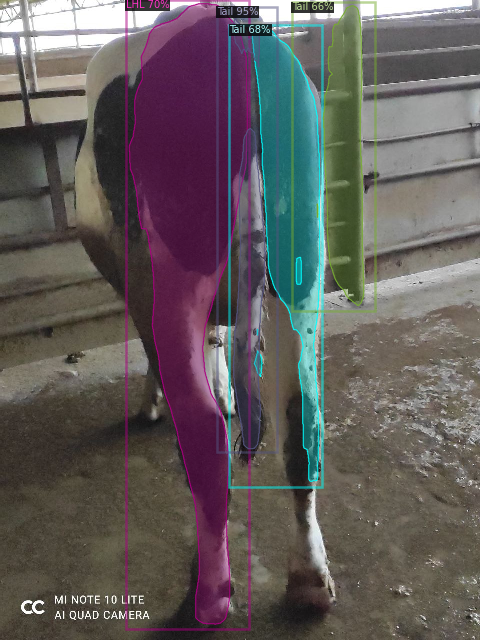

./cow/test/1_Holstein_Back_LiveWeight_490_CarcassWeight_254_05.jpg
tensor([2, 1, 1], device='cuda:0')
Boxes(tensor([[ 321.9125,   69.8118,  597.4872, 1090.8281],
        [ 558.6849,   60.7640,  629.6923,  725.8755],
        [ 485.0389,   53.6954,  638.5377,  803.8636]], device='cuda:0'))


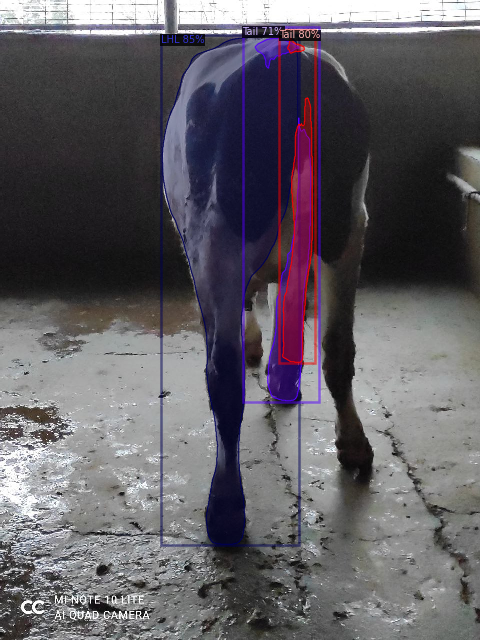

./cow/test/1_Holstein_Side_LiveWeight_490_CarcassWeight_254_04.jpg
tensor([0, 5, 1, 2, 0], device='cuda:0')
Boxes(tensor([[  27.1269,  131.7994,  284.9583,  362.8267],
        [ 408.7708,  181.9623,  593.1087,  819.7318],
        [ 977.1462,  185.8694, 1074.7347,  613.1769],
        [ 862.0457,  175.6671, 1080.0863,  809.2725],
        [ 577.3522,  168.3640,  763.3532,  510.4525]], device='cuda:0'))


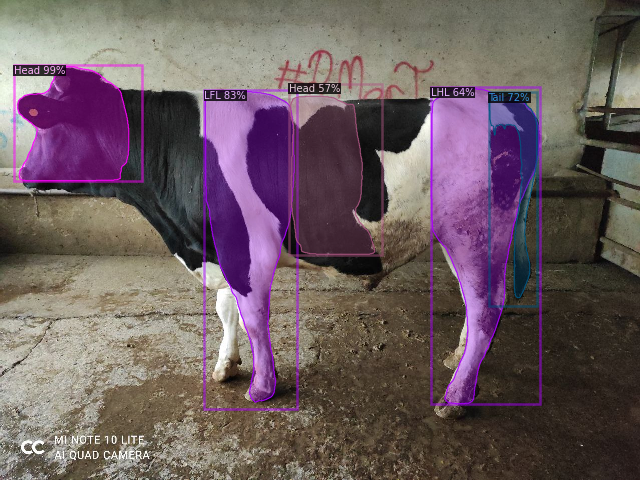

./cow/test/1_Holstein_Back_LiveWeight_490_CarcassWeight_254_06.jpg
tensor([0, 1, 5, 1, 2], device='cuda:0')
Boxes(tensor([[  11.5376,  348.2578,  235.3686,  592.0529],
        [ 584.0956,  291.9914,  688.8098,  777.7098],
        [ 218.4374,  318.0464,  357.8723,  845.5345],
        [ 307.2277,  326.2531,  398.8233,  758.3334],
        [ 322.4716,  268.5850,  579.1329, 1097.7604]], device='cuda:0'))


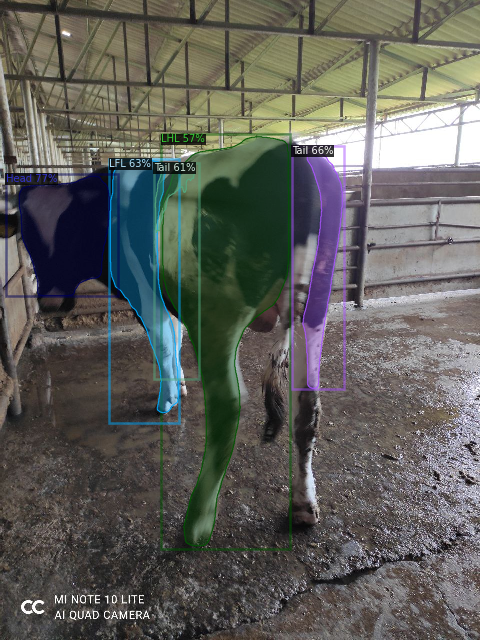

./cow/test/1_Holstein_Back_LiveWeight_490_CarcassWeight_254_04.jpg
tensor([1, 2, 0], device='cuda:0')
Boxes(tensor([[ 411.0038,   98.8526,  517.9822,  982.6992],
        [ 190.5358,   74.3466,  463.7235, 1251.5289],
        [ 267.8087,   59.9872,  414.0240,  149.0811]], device='cuda:0'))


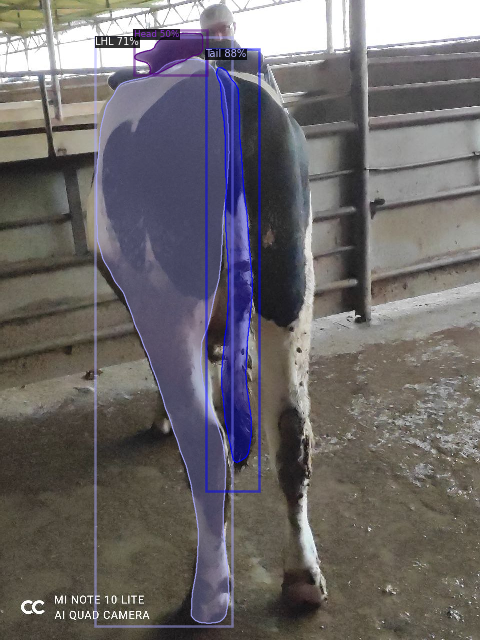

In [16]:
#tahminler
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("cow_test1")
for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    print(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    print(outputs["instances"].pred_classes)
    print(outputs["instances"].pred_boxes)
    v = Visualizer(im[:, :, ::-1],
                   metadata=cow_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70. Not bad!

In [17]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("cow_test1", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "cow_test1")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[06/03 17:57:17 d2.data.datasets.coco]: Loaded 15 images in COCO format from ./cow/test/test_coco.json
[06/03 17:57:17 d2.data.build]: Distribution of instances among all 6 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|    RHL     | 13           |    LHL     | 15           |    Tail    | 14           |
|    LFL     | 15           |    RFL     | 13           |    Head    | 9            |
|            |              |            |              |            |              |
|   total    | 79           |            |              |            |              |
[06/03 17:57:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[06/03 17:57:17 d2.data.common]: Serializing 15 elements to byte tensors and concatenating them all ...
[06/03 17:57:17 